# Aides aux Entreprises - PDF Reports

## Imports

In [82]:
import json
import os
import datetime
import random
import openpyxl

from urllib.request import urlopen
import urllib

import plotly.graph_objects as go
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

import pandas as pd
import numpy as np

from fpdf import FPDF
%matplotlib inline

In [85]:
sns.set_style("darkgrid")

## Functions

In [72]:
def import_json_to_dict(url) :
    response = urllib.request.urlopen(url)
    my_dict = json.loads(response.read())
    return my_dict

In [73]:
def mkdir_ifnotexist(path) :
    if not os.path.isdir(path) :
        os.mkdir(path)

In [74]:
def format_number_to_str(x) :
    if x == x :
        res = str(format(int(round(float(x),0)),",")).replace(","," ").replace(".",",")
    else :
        res = 'NaN'
    return res

In [75]:
def format_number_to_million_str(x) :
    if x == x :
        res = str(round(float(x)/1000000,1)).replace('.',',')
    else :
        res = 'NaN'
    return res

In [76]:
def format_str_to_int(x) :
    if x != 'None' :
        res = int(float(x))
    else : 
        res = None
    return res

In [133]:
def clean_str(s):
    d = {
        "’": "'",
        "\xa0": " "
        }
    for x in d:
        s = s.replace(x, d[x])
    return s

In [77]:
def shorten_long_naf_libelle(libelle) :
    if libelle == "Production et distribution d'eau ; assainissement, gestion des déchets et dépollution" :
        return "Prod./dist. eau, assainissement, déchets, dépollution"
    else :
        return libelle

In [78]:
months_fr_dict = {
    '01':'janvier',
    '02':'février',
    '03':'mars',
    '04':'avril',
    '05':'mai',
    '06':'juin',
    '07':'juillet',
    '08':'août',
    '09':'septembre',
    '10':'octobre',
    '11':'novembre',
    '12':'décembre'
}

# yearmonth should be in '2020-01' format

def yearmonth_to_fr(yearmonth) :
    month = yearmonth[-2:]
    year = yearmonth[:4]
    
    return months_fr_dict[month] + ' ' + year

In [79]:
def make_chart(aide, kpi, maille, chart_type, x_col, y_col, x_label, y_label, others_y_val, title, legend_title=None, show=False, sort_by_y_col_inc=False, sort_by_y_col_dec=False, stack_order=None, dep=None, reg=None, text_col=None, stack_col=None, color_col='color') :
    
    data_path = './data/{}-{}-{}.csv'.format(aide, kpi, maille)
    
    if os.path.isfile(data_path) :
    
        #Loading data
        if maille == 'regional' :
            dtype={'reg':'str'}
        elif maille == 'departemental' :
            dtype={'dep':'str'}
        else :
            dtype={}
        
        df = pd.read_csv(data_path, dtype=dtype)

        #Filtering if departemental or regional
        if maille == 'departemental' :
            df['dep'] = df['dep'].apply(str)
            df = df[df['dep'] == dep]
            if len(df) == 0 :
                fig = None
                print('No data to plot for {}-{}-{}-{}'.format(aide, kpi, maille, dep))
        elif maille == 'regional' :
            df['reg'] = df['reg'].apply(str)
            df = df[df['reg'] == reg]
            if len(df) == 0 :
                fig = None
                print('No data to plot for {}-{}-{}-{}'.format(aide, kpi, maille, reg))

        if len(df) > 0 :

            #Sorting by x_col and putting "Others" (others_y_val) in the end
            if sort_by_y_col_inc == True :
                df_plot = pd.concat([df[df[y_col] != others_y_val].sort_values(by=y_col, ascending=True), df[df[y_col] == others_y_val]]).reset_index(drop=True)
            elif sort_by_y_col_dec == True :
                df_plot = pd.concat([df[df[y_col] != others_y_val].sort_values(by=y_col, ascending=False), df[df[y_col] == others_y_val]]).reset_index(drop=True)
            else : #sort by decreasing x_col value by default
                df_plot = pd.concat([df[df[y_col] != others_y_val].sort_values(by=x_col, ascending=False), df[df[y_col] == others_y_val]]).reset_index(drop=True)    
            
            if stack_order is not None :
                df_stack_list = []
                for stack_val in stack_order :
                    df_stack = df_plot[df_plot[stack_col] == stack_val]
                    df_stack_list += [df_stack]
                
                df_plot = pd.concat(df_stack_list).reset_index(drop=True)
            
            #Parameters for plotting
            if text_col is not None :
                text = text_col
            else :
                text = x_col + '_fr'

            if chart_type == 'hbar' :

                df_plot[y_col] = df_plot[y_col].apply(lambda x : x+'   ')
                color_discrete_map = {key:value for (key,value) in zip(df_plot[y_col], df_plot[color_col])}

                fig = px.bar(df_plot, x=x_col, y=y_col,
                         labels={y_col:y_label,x_col:x_label}, 
                         height=550,
                         width=800,
                         color=y_col,
                         color_discrete_map = color_discrete_map,
                         orientation='h',
                         text=text,
                         title=title)
                fig.update_layout(showlegend=False)
                fig.layout['xaxis'].tickfont = dict(color = 'rgba(0,0,0,0)')
                fig.layout['xaxis'].showgrid = False
                fig.for_each_trace(lambda t: t.update(textfont_color='white', insidetextanchor='middle', textposition='inside'))

            elif chart_type == 'sthbar' :

                color_discrete_map = {key:value for (key,value) in zip(df_plot[stack_col], df_plot[color_col])}

                fig = px.bar(df_plot, x=x_col, y=y_col,
                         labels={y_col:y_label,x_col:x_label, stack_col:legend_title}, 
                         height=550,
                         width=800,
                         color=stack_col,
                         color_discrete_map = color_discrete_map,
                         orientation='h',
                         title=title)
                
                fig.update_yaxes(type='category', categoryorder='category descending')
                fig.layout['yaxis'].tickmode = 'array'
                fig.layout['yaxis'].tickvals = sorted(list(set(df_plot['mois'])), reverse=True)
                fig.layout['yaxis'].ticktext = [yearmonth_to_fr(yearmonth) + '   ' for yearmonth in sorted(list(set(df_plot['mois'])), reverse=True)]

            elif chart_type == 'dpie' :

                color_discrete_map = {key:value for (key,value) in zip(df_plot[y_col], df_plot[color_col])}

                fig = px.pie(df_plot, values=x_col, names=y_col,
                     labels={y_col:y_label,x_col:x_label}, 
                     height=400,
                     width=600,
                     hole=0.5,
                     color=y_col,
                     color_discrete_map = color_discrete_map,
                     title=title)

                fig.for_each_trace(lambda t: t.update(textfont_color='white', textposition='inside'))

            #Center the main title
            fig.update_layout(title={'x':0.5, 'xanchor': 'center'})

            if show == True :
                fig.show()
    
    else :
        fig = None
        print('File not found: {}'.format(data_path))
    
    return fig

In [580]:
def pp_plot(df_plot, mesure, short_indic, geo):
    plt.figure(mesure+short_indic+geo)
    ax = sns.lineplot(data=df_plot, x="period_date", y="financials_cumulated_amount", marker="o")
    plt.xlabel("")
    plt.ylabel(short_indic)
    plt.title(f"{mesure} - {geo}")
    plt.xticks(
        rotation=45, 
        horizontalalignment='right',
        fontweight='light',
        fontsize='x-large'  
    )
    #plt.show()
    return ax

In [581]:
def save_pp_plot(maille, geo, mesure, short_indic, ax):
    print(maille, geo, mesure, short_indic)
    path = os.path.join("pp_img", maille, geo)
    ax.figure.savefig(os.path.join(path, f"{mesure}-{short_indic}.png"))

In [582]:
def make_pp_chart(maille, mesure, short_indic) :
    if maille == "departemental":
        df = pp_dep.loc[(pp_dep.short_mesure == mesure) 
                        & (pp_dep.short_indic == short_indic)
                        & (pp_dep.period_date < "2025-01-01")].copy()
        departements = df.departement.unique()

        for departement in departements:
            df_plot = df.loc[(df.departement == departement)].sort_values(by="period_date")
            dep = df_plot.dep.iloc[0]
            ax = pp_plot(df_plot, mesure, short_indic, departement)
            save_pp_plot(maille, dep, mesure, short_indic, ax)
    elif maille == "regional":
        df = pp_reg.loc[(pp_reg.short_mesure == mesure) 
                & (pp_reg.short_indic == short_indic)
                & (pp_reg.period_date < "2025-01-01")].sort_values(by="period_date").copy()
        regions = df.region.unique()

        for region in regions:
            df_plot = df.loc[(df.region == region)]
            reg = df_plot.reg.iloc[0]
            ax = pp_plot(df_plot, mesure, short_indic, region)
            save_pp_plot(maille, reg, mesure, short_indic, ax)
    elif maille == "national":
        df = pp_nat.loc[(pp_nat.short_mesure == mesure) 
                & (pp_nat.short_indic == short_indic)
                & (pp_nat.period_date < "2025-01-01")].sort_values(by="period_date").copy()
        ax = pp_plot(df, mesure, short_indic, "France")
        save_pp_plot(maille, "France", mesure, short_indic, ax)

In [583]:
len(list_mesure_indic)

20

national France AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
national France AAP Efficacité énergétique Montant investissement total
national France AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
national France Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
national France France Num Nombre d'accompagnements dispensés
national France Guichet efficacité énergétique Nombre d'entreprises bénéficiaires
national France Guichet efficacité énergétique Nombre de PME,TPE bénéficiaires
national France Renforcement subventions Business France Nombre d'entreprises bénéficiaires
national France Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
national France Service civique Nombre d'entrées en service civique
national France Soutien aux projets industriels territoires Montant total des projets
national France Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
national France Soutien aux projet

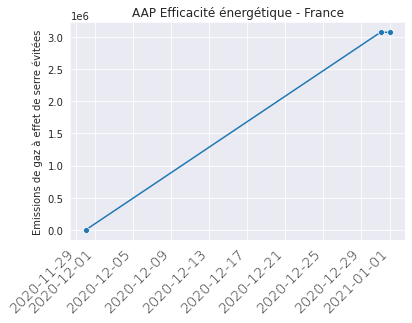

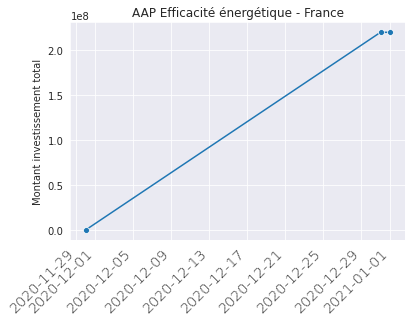

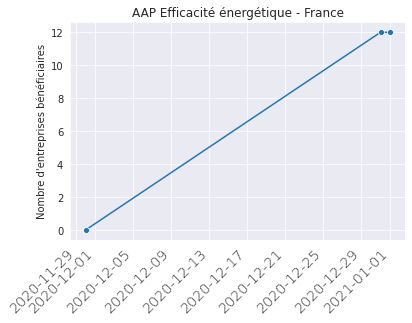

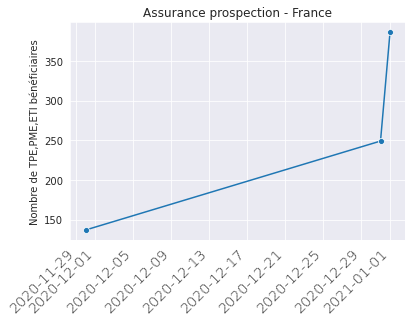

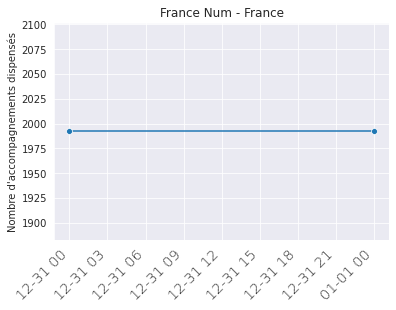

...

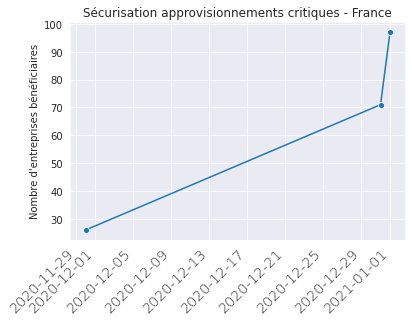

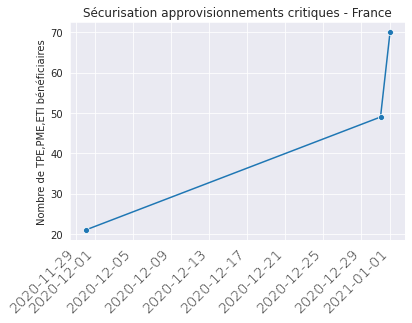

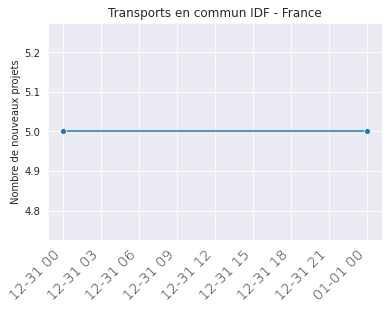

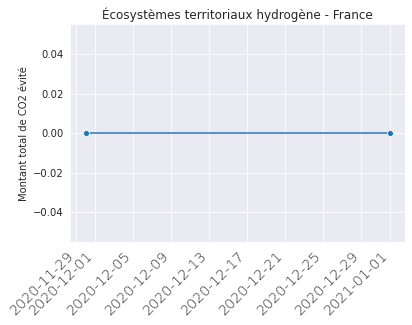

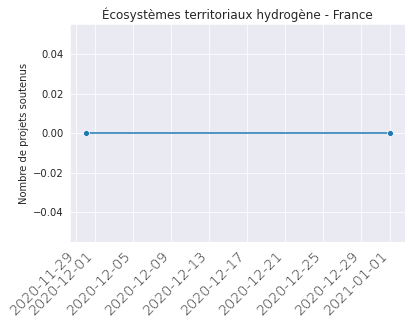

In [637]:
maille = "national"
for mesure, short_indic in list_mesure_indic:   
    make_pp_chart(maille, mesure, short_indic)

regional 01 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 53 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 52 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 76 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 44 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 32 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 28 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 27 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 84 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 24 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 11 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 06 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
regional 75 AAP Efficacité é

<ipython-input-580-6b41967e41cf>:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



regional 76 AAP Efficacité énergétique Montant investissement total
regional 44 AAP Efficacité énergétique Montant investissement total
regional 32 AAP Efficacité énergétique Montant investissement total
regional 28 AAP Efficacité énergétique Montant investissement total
regional 27 AAP Efficacité énergétique Montant investissement total
regional 84 AAP Efficacité énergétique Montant investissement total
regional 24 AAP Efficacité énergétique Montant investissement total
regional 11 AAP Efficacité énergétique Montant investissement total
regional 06 AAP Efficacité énergétique Montant investissement total
regional 75 AAP Efficacité énergétique Montant investissement total
regional 94 AAP Efficacité énergétique Montant investissement total
regional 04 AAP Efficacité énergétique Montant investissement total
regional 02 AAP Efficacité énergétique Montant investissement total
regional 03 AAP Efficacité énergétique Montant investissement total
regional 93 AAP Efficacité énergétique Montant i

regional 06 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
regional 75 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
regional 94 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
regional 04 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
regional 02 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
regional 03 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
regional 93 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
regional 01 Service civique Nombre d'entrées en service civique
regional 53 Service civique Nombre d'entrées en service civique
regional 52 Service civique Nombre d'entrées en service civique
regional 76 Service civique Nombre d'entrées en service civique
regional 44 Service civique Nombre d'entrées en service civique
regional 32 Service civique Nombre d'entrées en service c

regional 75 Sécurisation approvisionnements critiques Montant total des projets
regional 28 Sécurisation approvisionnements critiques Montant total des projets
regional 32 Sécurisation approvisionnements critiques Montant total des projets
regional 52 Sécurisation approvisionnements critiques Montant total des projets
regional 44 Sécurisation approvisionnements critiques Montant total des projets
regional 76 Sécurisation approvisionnements critiques Montant total des projets
regional 53 Sécurisation approvisionnements critiques Montant total des projets
regional 11 Sécurisation approvisionnements critiques Nombre d'entreprises bénéficiaires
regional 93 Sécurisation approvisionnements critiques Nombre d'entreprises bénéficiaires
regional 24 Sécurisation approvisionnements critiques Nombre d'entreprises bénéficiaires
regional 84 Sécurisation approvisionnements critiques Nombre d'entreprises bénéficiaires
regional 27 Sécurisation approvisionnements critiques Nombre d'entreprises bénéficia

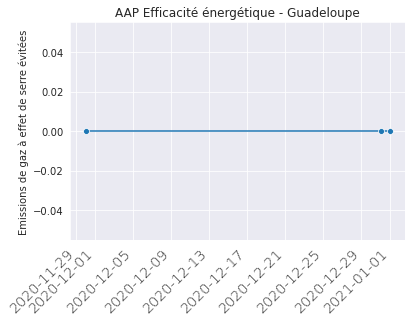

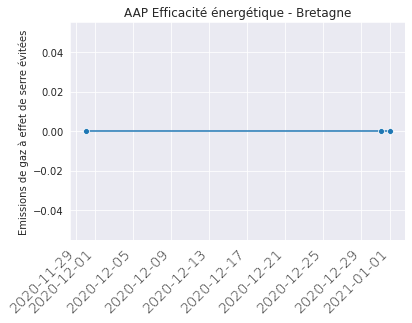

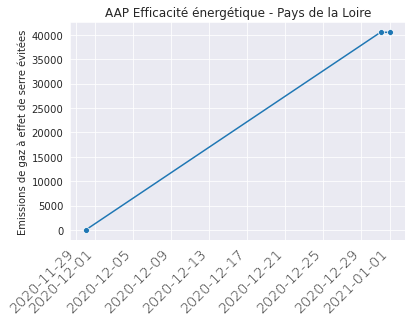

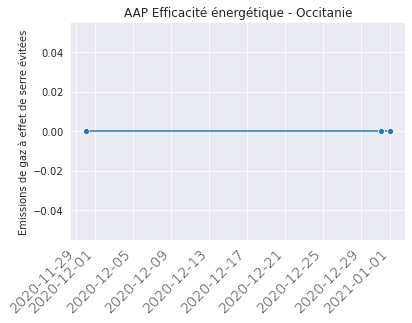

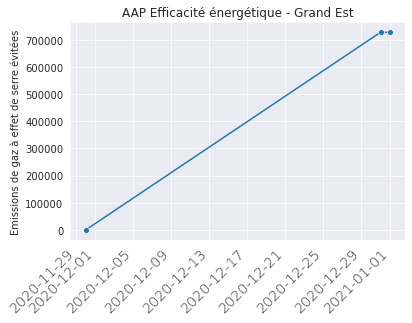

...

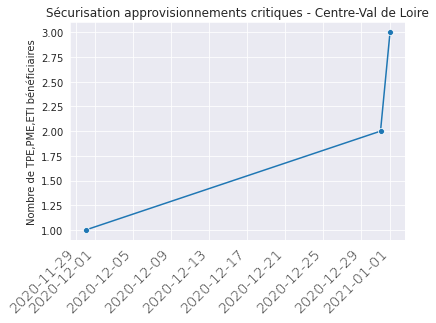

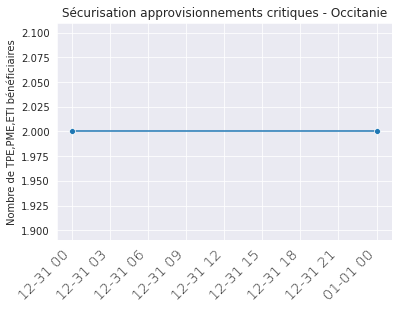

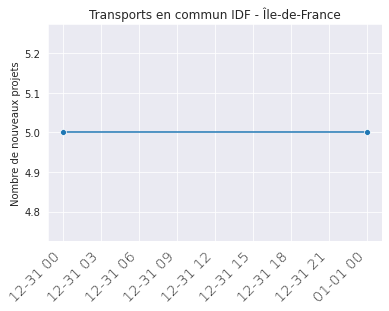

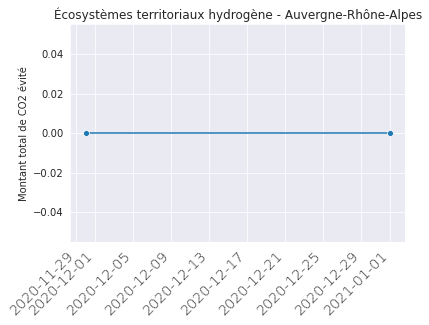

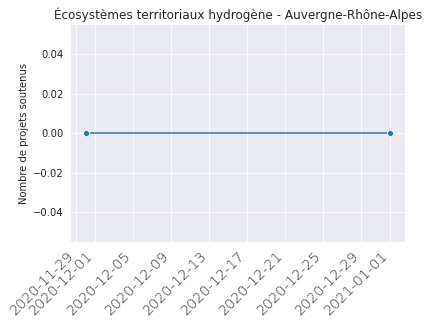

In [638]:
maille = "regional"
for mesure, short_indic in list_mesure_indic:   
    make_pp_chart(maille, mesure, short_indic)

departemental 63 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 976 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 79 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 27 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 12 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 77 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 59 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 50 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 21 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 10 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 82 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 04 AAP Efficacité énergétique Emissions

<ipython-input-580-6b41967e41cf>:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



departemental 57 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 15 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 60 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 45 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 36 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 83 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 972 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 43 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 68 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 971 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 31 AAP Efficacité énergétique Emissions de gaz à effet de serre évitées
departemental 41 AAP Efficacité énergétique Emission

departemental 57 AAP Efficacité énergétique Montant investissement total
departemental 15 AAP Efficacité énergétique Montant investissement total
departemental 60 AAP Efficacité énergétique Montant investissement total
departemental 45 AAP Efficacité énergétique Montant investissement total
departemental 36 AAP Efficacité énergétique Montant investissement total
departemental 83 AAP Efficacité énergétique Montant investissement total
departemental 972 AAP Efficacité énergétique Montant investissement total
departemental 43 AAP Efficacité énergétique Montant investissement total
departemental 68 AAP Efficacité énergétique Montant investissement total
departemental 971 AAP Efficacité énergétique Montant investissement total
departemental 31 AAP Efficacité énergétique Montant investissement total
departemental 41 AAP Efficacité énergétique Montant investissement total
departemental 67 AAP Efficacité énergétique Montant investissement total
departemental 973 AAP Efficacité énergétique Mont

departemental 67 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 973 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 94 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 90 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 70 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 46 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 69 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 35 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 11 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 33 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 48 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 25 AAP Efficacité énergétique Nombre d'entreprises bénéficiaires
departemental 28 AAP Efficacité énergétique Nombre 

departemental 29 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 92 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 65 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 84 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 45 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 15 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 23 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 57 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 54 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 33 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 61 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 52 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 71 Assurance prospection Nombre de TPE,PME,ETI bénéficiaires
departemental 56 Assuranc

departemental 21 France Num Nombre d'accompagnements dispensés
departemental 24 France Num Nombre d'accompagnements dispensés
departemental 62 France Num Nombre d'accompagnements dispensés
departemental 71 France Num Nombre d'accompagnements dispensés
departemental 05 France Num Nombre d'accompagnements dispensés
departemental 60 France Num Nombre d'accompagnements dispensés
departemental 27 France Num Nombre d'accompagnements dispensés
departemental 02 France Num Nombre d'accompagnements dispensés
departemental 08 France Num Nombre d'accompagnements dispensés
departemental 06 France Num Nombre d'accompagnements dispensés
departemental 03 France Num Nombre d'accompagnements dispensés
departemental 37 France Num Nombre d'accompagnements dispensés
departemental 58 France Num Nombre d'accompagnements dispensés
departemental 66 France Num Nombre d'accompagnements dispensés
departemental 976 France Num Nombre d'accompagnements dispensés
departemental 13 France Num Nombre d'accompagnements d

departemental 86 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 18 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 971 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 64 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 83 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 57 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 50 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 972 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 90 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 973 Renforcement subventions Business France Nombre d'entreprises bénéficiaires
departemental 79 Renforcement subventions Business France Nombre d'

departemental 52 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 38 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 37 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 67 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 01 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 68 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 36 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 03 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 23 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 87 Renforcement subventions Business France Nombre de TPE,PME,ETI bénéficiaires
departemental 86 Renforcement subventions Business France No

departemental 10 Service civique Nombre d'entrées en service civique
departemental 63 Service civique Nombre d'entrées en service civique
departemental 05 Service civique Nombre d'entrées en service civique
departemental 74 Service civique Nombre d'entrées en service civique
departemental 57 Service civique Nombre d'entrées en service civique
departemental 41 Service civique Nombre d'entrées en service civique
departemental 61 Service civique Nombre d'entrées en service civique
departemental 13 Service civique Nombre d'entrées en service civique
departemental 77 Service civique Nombre d'entrées en service civique
departemental 69 Service civique Nombre d'entrées en service civique
departemental 58 Service civique Nombre d'entrées en service civique
departemental 54 Service civique Nombre d'entrées en service civique
departemental 65 Service civique Nombre d'entrées en service civique
departemental 81 Service civique Nombre d'entrées en service civique
departemental 40 Service civique N

departemental 81 Soutien aux projets industriels territoires Montant total des projets
departemental 45 Soutien aux projets industriels territoires Montant total des projets
departemental 23 Soutien aux projets industriels territoires Montant total des projets
departemental 54 Soutien aux projets industriels territoires Montant total des projets
departemental 974 Soutien aux projets industriels territoires Montant total des projets
departemental 82 Soutien aux projets industriels territoires Montant total des projets
departemental 12 Soutien aux projets industriels territoires Montant total des projets
departemental 43 Soutien aux projets industriels territoires Montant total des projets
departemental 24 Soutien aux projets industriels territoires Montant total des projets
departemental 79 Soutien aux projets industriels territoires Montant total des projets
departemental 28 Soutien aux projets industriels territoires Montant total des projets
departemental 70 Soutien aux projets indus

departemental 80 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 62 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 13 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 51 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 38 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 85 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 73 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 74 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 81 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 45 Soutien aux projets industriels territoires Nombre d'entreprises bénéficiaires
departemental 23 Soutien aux projets ind

departemental 09 Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 07 Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 2B Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 75 Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 40 Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 94 Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 48 Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 53 Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 67 Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 87 Soutien aux projets industriels territoires Nombre de TPE,PME,ETI bénéficiaires
departemental 93 Soutien aux p

departemental 65 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 25 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 57 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 78 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 55 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 06 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 04 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 79 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 89 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 14 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 23 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 69 Soutien recherche aéronautique civil Nombre de projets soutenus
departemental 976 Soutien re

departemental 54 Sécurisation approvisionnements critiques Montant total des projets
departemental 14 Sécurisation approvisionnements critiques Montant total des projets
departemental 94 Sécurisation approvisionnements critiques Montant total des projets
departemental 13 Sécurisation approvisionnements critiques Montant total des projets
departemental 91 Sécurisation approvisionnements critiques Montant total des projets
departemental 31 Sécurisation approvisionnements critiques Montant total des projets
departemental 72 Sécurisation approvisionnements critiques Montant total des projets
departemental 19 Sécurisation approvisionnements critiques Montant total des projets
departemental 69 Sécurisation approvisionnements critiques Montant total des projets
departemental 92 Sécurisation approvisionnements critiques Montant total des projets
departemental 36 Sécurisation approvisionnements critiques Montant total des projets
departemental 85 Sécurisation approvisionnements critiques Montan

departemental 69 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 92 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 36 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 57 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 62 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 67 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 26 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 49 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 33 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 38 Sécurisation approvisionnements critiques Nombre de TPE,PME,ETI bénéficiaires
departemental 44 Sécurisation approvisionnements c

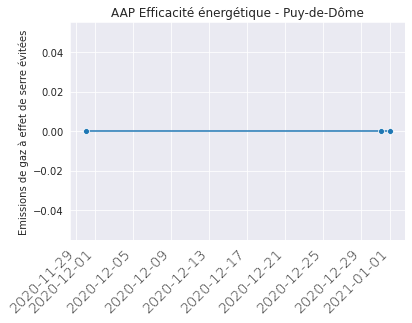

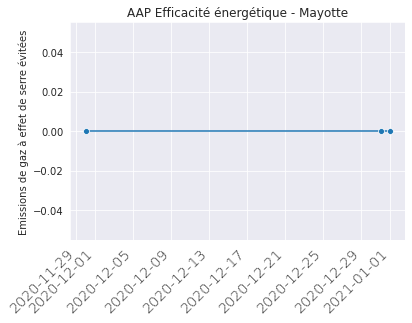

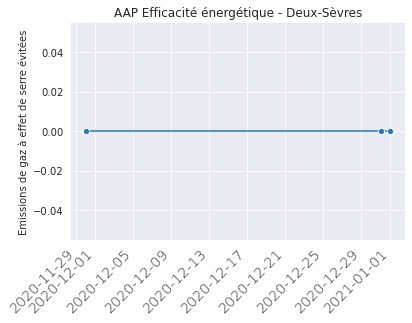

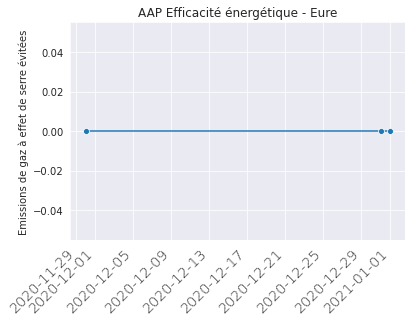

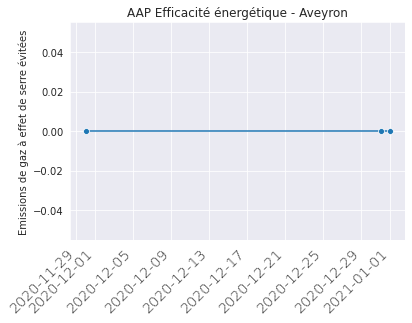

...

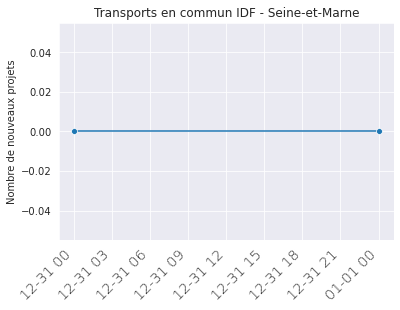

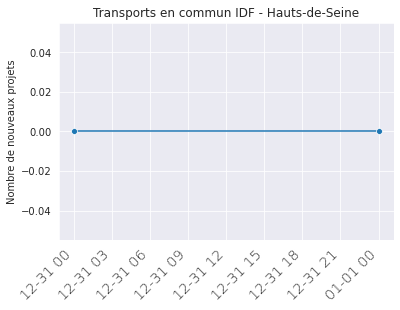

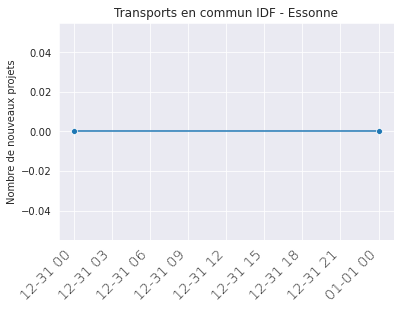

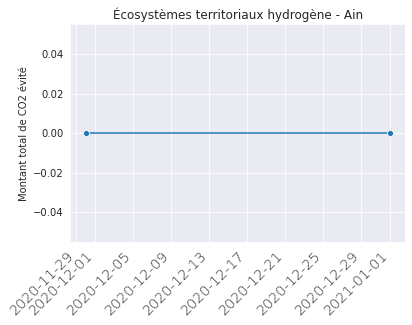

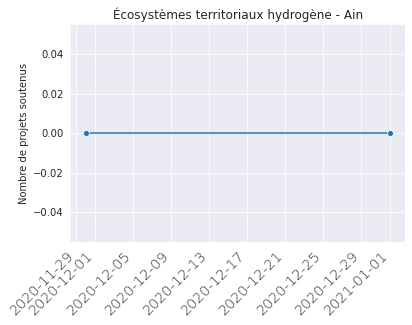

In [639]:
maille = "departemental"
for mesure, short_indic in list_mesure_indic: 
    make_pp_chart(maille, mesure, short_indic)

## Parameters

In [13]:
data_dir_path = './data/'
img_dir_path = './img/'
reports_dir_path = './reports/'

In [327]:
pp_img_dir_path = './pp_img'

In [14]:
#Taxonomies

taxo_nafsec_url = 'https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/taxonomies/sections-naf-minify.json'
taxo_jurcat_url = 'https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/taxonomies/categories-juridiques-minify.json'
taxo_effcla_url = 'https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/taxonomies/classes-effectifs-minify.json'
taxo_nace17_url = 'https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/taxonomies/sections-nace17-minify.json'

taxo_dep_url = 'https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/taxonomies/departements-minify.json'
taxo_reg_url = 'https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/taxonomies/regions-minify.json'

In [15]:
mailles_list = ['national', 'regional', 'departemental']

In [16]:
#DATA PROCESSING: KPIs to process
aides_charts_kpi_dict = {
    'aides': ['kpi_top_10_naf', 'kpi_categorie_juridique', 'kpi_classe_effectif'],
    'pge':['kpi_top_10_naf'],
    'report':['kpi_top_10_naf'],
    'cpsti':['kpi_top_10_naf'],
    'activite-partielle':['nace17']
}

#TODO: macro KPIs
aides_macro_kpi_dict = {
    'aides': ['montant', 'nombre', 'nombre_siren'],
    'pge':['montant', 'nombre'],
    'report':['montant', 'nombre'],
    'cpsti':['montant', 'nombre'],
    'activite-partielle':['nombre_salaries_concernes', 'nombre_etablissements_concernes', 'nombre_heures_demandees']
}

In [17]:
#PLOTTING: parameters for graphs
#As of now, we consider these graphs are the same for national, regional and departemental

graph_params_list = [
    
    #Fonds de solidarité
    dict(aide='aides',
         kpi='kpi_top_10_naf',
         x_col='montant',
         y_col='libelle_section_naf',
         x_label='',
         y_label='Section NAF',
         others_y_val='Autres sections NAF',
         title='Top 10 des aides du fonds de solidarité<br />ventilées par code section NAF (en M€)',
         chart_type='hbar'
        ),
    dict(aide='aides',
         kpi='kpi_categorie_juridique',
         maille='national',
         x_col='montant',
         y_col='libelle_cat_juridique',
         x_label='',
         y_label="Catégorie juridique",
         others_y_val="Autres Catégories Juridiques",
         title='Top 3 des aides du fonds de solidarité<br />ventilées par catégories juridiques (en M€)',
         chart_type='dpie'
        ),
    dict(aide='aides',
         kpi='kpi_classe_effectif',
         x_col='montant',
         y_col='libelle_classe_effectif',
         x_label='',
         y_label="Classe d'effectif",
         sort_by_y_col_dec=True,
         others_y_val="Autres Classes d'Effectifs",
         title="Aides du fonds de solidarité<br />ventilées par classes d'effectifs (en M€)",
         chart_type='hbar'
        ),
    
    #Prêts garantis par l'Etat
    dict(aide='pge',
         kpi='kpi_top_10_naf',
         maille='national',
         x_col='montant',
         y_col='libelle_section_naf',
         x_label='',
         y_label='Section NAF',
         others_y_val='Autres sections NAF',
         title="Top 10 des prêts garantis par l'Etat<br />ventilés par code section NAF (en M€)",
         chart_type='hbar'
        ),
    
    #Reports d'échéances fiscales
    dict(aide='report',
         kpi='kpi_top_10_naf',
         x_col='montant',
         y_col='libelle_section_naf',
         x_label='',
         y_label='Section NAF',
         others_y_val='Autres sections NAF',
         title="Top 10 des reports d'échéances fiscales<br />ventilés par code section NAF (en M€)",
         chart_type='hbar'
        ),
    
    #Aides artisans/commerçants
    dict(aide='cpsti',
         kpi='kpi_top_10_naf',
         x_col='montant',
         y_col='libelle_section_naf',
         x_label='',
         y_label='Section NAF',
         others_y_val='Autres sections NAF',
         title="Top 10 des aides CPSTI<br />ventilés par code section NAF (en M€)",
         chart_type='hbar'
        ),
    
    #Activité partielle
    dict(aide='activite-partielle',
         kpi='nace17',
         x_col='nombre_salaries_concernes',
         y_col='mois',
         stack_col='libelle',
         x_label='',
         y_label='Mois',
         sort_by_y_col_inc=True,
         others_y_val='Autres sections NACE 17',
         stack_order=['Commerce', "Act. scientif. et tech. ; services admin. et de soutien", 'Hébergement et restauration', 'Construction', "Fabrication d'autres produits indus.", 'Autres sections NACE 17'],
         title="Nombre de salariés concernés par l'activité partielle<br />ventilés par code section NACE 17",
         legend_title=' ',
         chart_type='sthbar'
        ),
]

## Loading taxonomies data

In [18]:
taxo_nafsec_df = pd.DataFrame(import_json_to_dict(taxo_nafsec_url))
taxo_jurcat_df = pd.DataFrame(import_json_to_dict(taxo_jurcat_url))
taxo_effcla_df = pd.DataFrame(import_json_to_dict(taxo_effcla_url))
taxo_nace17_df = pd.DataFrame(import_json_to_dict(taxo_nace17_url))

taxo_dep_df = pd.DataFrame(import_json_to_dict(taxo_dep_url))
taxo_reg_df = pd.DataFrame(import_json_to_dict(taxo_reg_url))

In [274]:
taxo_reg_df.head(20)

,cheflieu,libelle,ncc,nccenr,reg,tncc
0,97105,Guadeloupe,GUADELOUPE,Guadeloupe,01,3
1,97209,Martinique,MARTINIQUE,Martinique,02,3
2,97302,Guyane,GUYANE,Guyane,03,3
3,97411,La Réunion,LA REUNION,La Réunion,04,0
4,97608,Mayotte,MAYOTTE,Mayotte,06,0
5,75056,Île-de-France,ILE DE FRANCE,Île-de-France,11,1
6,45234,Centre-Val de Loire,CENTRE VAL DE LOIRE,Centre-Val de Loire,24,2
7,21231,Bourgogne-Franche-Comté,BOURGOGNE FRANCHE COMTE,Bourgogne-Franche-Comté,27,0
8,76540,Normandie,NORMANDIE,Normandie,28,0
9,59350,Hauts-de-France,HAUTS DE FRANCE,Hauts-de-France,32,4


In [273]:
taxo_reg_df.reg.unique()

array(['01', '02', '03', '04', '06', '11', '24', '27', '28', '32', '44',
       '52', '53', '75', '76', '84', '93', '94'], dtype=object)

In [20]:
propilot_path = os.path.join("data", "data_propilot")

In [550]:
df_effects = pd.read_csv(os.path.join(propilot_path, "dim_effects_202101281645.csv"), sep=";")
df_maturities = pd.read_csv(os.path.join(propilot_path, "dim_maturities_202101281645.csv"), sep=";")
df_periods = pd.read_csv(os.path.join(propilot_path, "dim_periods_202101281645.csv"), sep=";")
df_properties = pd.read_csv(os.path.join(propilot_path, "dim_properties_202101281645.csv"), sep=";")
df_snapshots = pd.read_csv(os.path.join(propilot_path, "dim_snapshots_202101281645.csv"), sep=";")
df_states = pd.read_csv(os.path.join(propilot_path, "dim_states_202101281645.csv"), sep=";")
df_structures = pd.read_csv(os.path.join(propilot_path, "dim_structures_202101281645.csv"), sep=";")
df_top_levels = pd.read_csv(os.path.join(propilot_path, "dim_top_levels_202101281645.csv"), sep=";")
df_tree_nodes = pd.read_csv(os.path.join(propilot_path, "dim_tree_nodes_202101281645.csv"), sep=";")
df_facts_financials = pd.read_csv(os.path.join(propilot_path, "fact_financials_202101281645.csv"), sep=";")
df_property_values = pd.read_csv(os.path.join(propilot_path, "fact_property_values_202101281645.csv"), sep=";")

In [607]:
df = (df_facts_financials
      .merge(df_tree_nodes, left_on="tree_node_id", right_on="tree_node_id")
      .merge(df_effects, left_on="effect_id", right_on="effect_id")
      .merge(df_states, left_on="state_id", right_on="state_id")
      .merge(df_periods, left_on="period_id", right_on="period_id")
      .merge(df_structures, left_on="structure_id", right_on="structure_id"))

In [608]:
cols = ["tree_node_name", "structure_name", "effect_id", "period_date", "financials_cumulated_amount"]
df=df[cols]
df = df.loc[df.period_date < "2025-01-01"]
df.period_date = pd.to_datetime(df.period_date)

In [609]:
df.structure_name.unique()

array(['Département', 'Région', 'Mesure'], dtype=object)

In [610]:
df.period_date.unique()

array(['2020-12-31T00:00:00.000000000', '2020-11-30T00:00:00.000000000',
       '2020-12-31T23:59:59.000000000'], dtype='datetime64[ns]')

In [611]:
effect_ids = sorted(list(df.effect_id.unique()))
effect_ids

['Emissions de gaz à effet de serre évitées sur la durée de vie des équipements - PEE',
 'Montant cumulé de l’investissement total ainsi déclenché - PEE',
 'Montant des fonds labellisés - GFP',
 'Montant total de CO2 évité - ETH',
 'Montant total des projets - PIT',
 'Montant total des projets - SAC',
 "Nombre d'accompagnements dispensés - FUM",
 'Nombre de PME/TPE - EEI',
 'Nombre de TPE/PME/ETI bénéficiaires - APR',
 'Nombre de TPE/PME/ETI bénéficiaires - PIT',
 'Nombre de TPE/PME/ETI bénéficiaires - SAC',
 'Nombre de TPE/PME/ETI bénéficiaires - SBF',
 'Nombre de chantiers engagés (écluses stations pompages, barrages) - VNA',
 'Nombre de fonds labellisés - GFP',
 'Nombre de nouveaux projets (nouvelle ligne, extension de ligne et pôle) - TCI',
 'Nombre de projets soutenus - DGA',
 'Nombre de projets soutenus - ETH',
 'Nombre de véhicules électriques et hybrides rechargeables achetés - VAI',
 'Nombre d’entreprises ayant reçu l’aide - EEI',
 'Nombre d’entreprises ayant reçu l’aide - PEE

In [612]:
df_dep = df[cols].loc[df.structure_name == "Département"]

In [613]:
df_dep["departement"] = df_dep["tree_node_name"].apply(lambda x: x.split("/")[0].strip())
df_dep["mesure"] = df_dep["tree_node_name"].apply(lambda x: x.split("/")[1].strip())
# on enlève un point surnuméraire.
df_dep["mesure"].replace("\.", "", regex=True,inplace=True)
df_dep.mesure = df_dep.mesure.apply(lambda x: clean_str(x))
df_dep.rename(columns={"effect_id":"indicateur"}, inplace=True)

In [614]:
dict_indicateur = {
'Emissions de gaz à effet de serre évitées sur la durée de vie des équipements - PEE' : 'Emissions de gaz à effet de serre évitées',
 'Montant cumulé de l’investissement total ainsi déclenché - PEE': "Montant investissement total",
 'Montant des fonds labellisés - GFP' : "Montant des fonds labellisés",
 'Montant total de CO2 évité - ETH' : 'Montant total de CO2 évité' ,
 'Montant total des projets - PIT' : "Montant total des projets",
 'Montant total des projets - SAC' : "Montant total des projets",
 "Nombre d'accompagnements dispensés - FUM" : "Nombre d'accompagnements dispensés",
 'Nombre de PME/TPE - EEI' : "Nombre de PME,TPE bénéficiaires",
 'Nombre de TPE/PME/ETI bénéficiaires - APR' : "Nombre de TPE,PME,ETI bénéficiaires",
 'Nombre de TPE/PME/ETI bénéficiaires - PIT' : "Nombre de TPE,PME,ETI bénéficiaires",
 'Nombre de TPE/PME/ETI bénéficiaires - SAC' : "Nombre de TPE,PME,ETI bénéficiaires",
 'Nombre de TPE/PME/ETI bénéficiaires - SBF' : "Nombre de TPE,PME,ETI bénéficiaires",
 'Nombre de chantiers engagés (écluses stations pompages, barrages) - VNA' : "Nombre de chantiers engagés",
 'Nombre de fonds labellisés - GFP' : "Nombre de fonds labellisés",
 'Nombre de nouveaux projets (nouvelle ligne, extension de ligne et pôle) - TCI' : "Nombre de nouveaux projets",
 'Nombre de projets soutenus - DGA' : "Nombre de projets soutenus",
 'Nombre de projets soutenus - ETH' : "Nombre de projets soutenus",
 'Nombre de véhicules électriques et hybrides rechargeables achetés - VAI' : "Nombre de véhicules électriques et hybrides rechargeables achetés",
 'Nombre d’entreprises ayant reçu l’aide - EEI' : "Nombre d'entreprises bénéficiaires",
 'Nombre d’entreprises ayant reçu l’aide - PEE' : "Nombre d'entreprises bénéficiaires",
 'Nombre d’entreprises bénéficiares - PIT' : "Nombre d'entreprises bénéficiaires",
 'Nombre d’entreprises bénéficiares - SAC' : "Nombre d'entreprises bénéficiaires",
 'Nombre d’entreprises bénéficiares - SBF' : "Nombre d'entreprises bénéficiaires",
 'Nombre d’entrées en service civique - SCI' : "Nombre d'entrées en service civique"
}
df_dep["short_indic"] = df_dep.indicateur.apply(lambda x: dict_indicateur[x])

In [615]:
pp_mesures = sorted(list(df_dep["mesure"].unique()))
pp_mesures

["Appels à projets pour les projets d'efficacité énergétique de grande ampleur et appels à manifestation d'intérêt sur les projets qui proposent une évolution profonde des procédés industriels",
 'Assurance prospection',
 'France Num',
 'Guichet efficacité énergétique dans industrie',
 'Relocalisation : soutien aux projets industriels dans les territoires',
 'Relocalisation : sécurisation des approvisionnements critiques',
 'Renforcement des subventions de Business France (chèque export, chèque VIE)',
 'Service civique',
 'Soutien à la recherche aéronautique civil',
 'Transports en commun Ile de France (RER, etc)',
 'Écosystèmes territoriaux hydrogène DGEC, AAP Ademe']

In [616]:
pp_short_mesures  = [
    "AAP Efficacité énergétique",
 'Assurance prospection',
 'France Num',
 'Guichet efficacité énergétique',
 'Soutien aux projets industriels territoires',
 'Sécurisation approvisionnements critiques',
 'Renforcement subventions Business France',
 'Service civique',
 'Soutien recherche aéronautique civil',
 'Transports en commun IDF',
 'Écosystèmes territoriaux hydrogène']

In [617]:
dict_mesures = {}
for mesure, short_mesure in zip(pp_mesures, pp_short_mesures):
    dict_mesures[mesure] = short_mesure
df_dep["short_mesure"] = df_dep.mesure.apply(lambda x: dict_mesures[x])
df_dep.head()

,tree_node_name,structure_name,indicateur,period_date,financials_cumulated_amount,departement,mesure,short_indic,short_mesure
0,Ille-et-Vilaine / Assurance prospection,Département,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,3,Ille-et-Vilaine,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection
1,Eure-et-Loir / Assurance prospection,Département,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,2,Eure-et-Loir,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection
2,Hautes-Alpes / Assurance prospection,Département,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,0,Hautes-Alpes,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection
3,Saint-Martin / Assurance prospection,Département,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,0,Saint-Martin,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection
4,Cher / Assurance prospection,Département,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,1,Cher,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection


In [618]:
list_mesure_indic = list(df_dep.pivot_table(index=["short_mesure", "short_indic"]).index)
list_mesure_indic

[('AAP Efficacité énergétique', 'Emissions de gaz à effet de serre évitées'),
 ('AAP Efficacité énergétique', 'Montant investissement total'),
 ('AAP Efficacité énergétique', "Nombre d'entreprises bénéficiaires"),
 ('Assurance prospection', 'Nombre de TPE,PME,ETI bénéficiaires'),
 ('France Num', "Nombre d'accompagnements dispensés"),
 ('Guichet efficacité énergétique', "Nombre d'entreprises bénéficiaires"),
 ('Guichet efficacité énergétique', 'Nombre de PME,TPE bénéficiaires'),
 ('Renforcement subventions Business France',
  "Nombre d'entreprises bénéficiaires"),
 ('Renforcement subventions Business France',
  'Nombre de TPE,PME,ETI bénéficiaires'),
 ('Service civique', "Nombre d'entrées en service civique"),
 ('Soutien aux projets industriels territoires', 'Montant total des projets'),
 ('Soutien aux projets industriels territoires',
  "Nombre d'entreprises bénéficiaires"),
 ('Soutien aux projets industriels territoires',
  'Nombre de TPE,PME,ETI bénéficiaires'),
 ('Soutien recherche 

In [619]:
dict_mesure_indic = {}
for x in list_mesure_indic:
    if x[0] in dict_mesure_indic:
        dict_mesure_indic[x[0]].append(x[1])
    else:
        dict_mesure_indic[x[0]] = [x[1]]
dict_mesure_indic

{'AAP Efficacité énergétique': ['Emissions de gaz à effet de serre évitées',
  'Montant investissement total',
  "Nombre d'entreprises bénéficiaires"],
 'Assurance prospection': ['Nombre de TPE,PME,ETI bénéficiaires'],
 'France Num': ["Nombre d'accompagnements dispensés"],
 'Guichet efficacité énergétique': ["Nombre d'entreprises bénéficiaires",
  'Nombre de PME,TPE bénéficiaires'],
 'Renforcement subventions Business France': ["Nombre d'entreprises bénéficiaires",
  'Nombre de TPE,PME,ETI bénéficiaires'],
 'Service civique': ["Nombre d'entrées en service civique"],
 'Soutien aux projets industriels territoires': ['Montant total des projets',
  "Nombre d'entreprises bénéficiaires",
  'Nombre de TPE,PME,ETI bénéficiaires'],
 'Soutien recherche aéronautique civil': ['Nombre de projets soutenus'],
 'Sécurisation approvisionnements critiques': ['Montant total des projets',
  "Nombre d'entreprises bénéficiaires",
  'Nombre de TPE,PME,ETI bénéficiaires'],
 'Transports en commun IDF': ['Nombr

In [620]:
print(df_dep.shape)
print(taxo_dep_df.shape)

(3747, 9)
(101, 7)


In [621]:
taxo_reg_df.head()

,cheflieu,libelle,ncc,nccenr,reg,tncc
0,97105,Guadeloupe,GUADELOUPE,Guadeloupe,01,3
1,97209,Martinique,MARTINIQUE,Martinique,02,3
2,97302,Guyane,GUYANE,Guyane,03,3
3,97411,La Réunion,LA REUNION,La Réunion,04,0
4,97608,Mayotte,MAYOTTE,Mayotte,06,0


In [622]:
df_dep_enr = df_dep.merge(taxo_dep_df[["dep", "reg", "libelle"]], 
                          how="left", left_on="departement", right_on="libelle")\
    .merge(taxo_reg_df[["reg", "nccenr"]], how="left", left_on="reg", right_on="reg")
df_dep_enr.drop(columns=["tree_node_name", "structure_name"], inplace=True)
df_dep_enr = df_dep_enr.loc[~df_dep_enr.dep.isna(), :]
df_dep_enr.rename(columns={"nccenr":"region"}, inplace=True)

In [623]:
df_dep_enr.shape

(3472, 11)

In [624]:
df_dep_enr.head()

,indicateur,period_date,financials_cumulated_amount,departement,mesure,short_indic,short_mesure,dep,reg,libelle,region
0,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,3,Ille-et-Vilaine,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection,35,53,Ille-et-Vilaine,Bretagne
1,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,2,Eure-et-Loir,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection,28,24,Eure-et-Loir,Centre-Val de Loire
2,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,0,Hautes-Alpes,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection,05,93,Hautes-Alpes,Provence-Alpes-Côte d'Azur
4,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,1,Cher,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection,18,24,Cher,Centre-Val de Loire
5,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31,11,Nord,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection,59,32,Nord,Hauts-de-France


In [625]:
pp_dep = df_dep_enr.copy()

In [626]:
pp_dep.shape

(3472, 11)

In [627]:
pp_dep.tail()

,indicateur,period_date,financials_cumulated_amount,departement,mesure,short_indic,short_mesure,dep,reg,libelle,region
3742,Nombre d’entrées en service civique - SCI,2020-12-31 23:59:59,1839,Seine-Saint-Denis,Service civique,Nombre d'entrées en service civique,Service civique,93,11,Seine-Saint-Denis,Île-de-France
3743,Nombre d’entrées en service civique - SCI,2020-12-31 23:59:59,319,Cantal,Service civique,Nombre d'entrées en service civique,Service civique,15,84,Cantal,Auvergne-Rhône-Alpes
3744,Nombre d’entrées en service civique - SCI,2020-12-31 23:59:59,969,Haut-Rhin,Service civique,Nombre d'entrées en service civique,Service civique,68,44,Haut-Rhin,Grand Est
3745,Nombre d’entrées en service civique - SCI,2020-12-31 23:59:59,640,Pyrénées-Orientales,Service civique,Nombre d'entrées en service civique,Service civique,66,76,Pyrénées-Orientales,Occitanie
3746,Nombre d’entrées en service civique - SCI,2020-12-31 23:59:59,830,Vaucluse,Service civique,Nombre d'entrées en service civique,Service civique,84,93,Vaucluse,Provence-Alpes-Côte d'Azur


In [628]:
pp_reg = pd.pivot_table(pp_dep, index=["mesure","short_mesure", "reg","region", "period_date","short_indic"], values="financials_cumulated_amount", aggfunc=np.sum)
pp_reg.rename(columns={"reg":"libelle"}, inplace=True)
pp_reg.reset_index(inplace=True)

In [629]:
pp_reg.shape

(696, 7)

In [630]:
pp_reg.tail()

,mesure,short_mesure,reg,region,period_date,short_indic,financials_cumulated_amount
691,"Transports en commun Ile de France (RER, etc)",Transports en commun IDF,11,Île-de-France,2020-12-31 23:59:59,Nombre de nouveaux projets,5
692,"Écosystèmes territoriaux hydrogène DGEC, AAP A...",Écosystèmes territoriaux hydrogène,84,Auvergne-Rhône-Alpes,2020-11-30 00:00:00,Montant total de CO2 évité,0
693,"Écosystèmes territoriaux hydrogène DGEC, AAP A...",Écosystèmes territoriaux hydrogène,84,Auvergne-Rhône-Alpes,2020-11-30 00:00:00,Nombre de projets soutenus,0
694,"Écosystèmes territoriaux hydrogène DGEC, AAP A...",Écosystèmes territoriaux hydrogène,84,Auvergne-Rhône-Alpes,2020-12-31 23:59:59,Montant total de CO2 évité,0
695,"Écosystèmes territoriaux hydrogène DGEC, AAP A...",Écosystèmes territoriaux hydrogène,84,Auvergne-Rhône-Alpes,2020-12-31 23:59:59,Nombre de projets soutenus,0


In [631]:
pp_nat = pd.pivot_table(pp_reg, index=["mesure", "short_mesure", "period_date", "short_indic"], values="financials_cumulated_amount", aggfunc=np.sum)
pp_nat.reset_index(inplace=True)

In [632]:
pp_nat.shape

(50, 5)

In [633]:
pp_nat.head(10)

,mesure,short_mesure,period_date,short_indic,financials_cumulated_amount
0,Appels à projets pour les projets d'efficacité...,AAP Efficacité énergétique,2020-11-30 00:00:00,Emissions de gaz à effet de serre évitées,0
1,Appels à projets pour les projets d'efficacité...,AAP Efficacité énergétique,2020-11-30 00:00:00,Montant investissement total,0
2,Appels à projets pour les projets d'efficacité...,AAP Efficacité énergétique,2020-11-30 00:00:00,Nombre d'entreprises bénéficiaires,0
3,Appels à projets pour les projets d'efficacité...,AAP Efficacité énergétique,2020-12-31 00:00:00,Emissions de gaz à effet de serre évitées,3068625
4,Appels à projets pour les projets d'efficacité...,AAP Efficacité énergétique,2020-12-31 00:00:00,Montant investissement total,219650709
5,Appels à projets pour les projets d'efficacité...,AAP Efficacité énergétique,2020-12-31 00:00:00,Nombre d'entreprises bénéficiaires,12
6,Appels à projets pour les projets d'efficacité...,AAP Efficacité énergétique,2020-12-31 23:59:59,Emissions de gaz à effet de serre évitées,3068625
7,Appels à projets pour les projets d'efficacité...,AAP Efficacité énergétique,2020-12-31 23:59:59,Montant investissement total,219650709
8,Appels à projets pour les projets d'efficacité...,AAP Efficacité énergétique,2020-12-31 23:59:59,Nombre d'entreprises bénéficiaires,12
9,Assurance prospection,Assurance prospection,2020-11-30 00:00:00,"Nombre de TPE,PME,ETI bénéficiaires",137


In [634]:
pp_dep.loc[(pp_dep.dep == "02") & (pp_dep.short_mesure == "Assurance prospection")]

,indicateur,period_date,financials_cumulated_amount,departement,mesure,short_indic,short_mesure,dep,reg,libelle,region
82,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31 00:00:00,1,Aisne,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection,02,32,Aisne,Hauts-de-France
642,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-11-30 00:00:00,0,Aisne,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection,02,32,Aisne,Hauts-de-France
1358,Nombre de TPE/PME/ETI bénéficiaires - APR,2020-12-31 23:59:59,1,Aisne,Assurance prospection,"Nombre de TPE,PME,ETI bénéficiaires",Assurance prospection,02,32,Aisne,Hauts-de-France


## Data pre-processing

In [507]:
%%time
#Charts data processing (one CSV file per aide type, KPI and maille)

mkdir_ifnotexist(data_dir_path)

for aide in aides_charts_kpi_dict.keys() :
    for maille in mailles_list :
        
        #Condition to drop when activite-partielle data is back to "normal" folder
        if aide != 'activite-partielle' : 
            url = "https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/{}/{}-maille-{}-minify.json".format(aide, aide, maille)
        else :
            url = "https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/{}3/{}-3-maille-{}-minify.json".format(aide, aide, maille)
            
        data = import_json_to_dict(url)
        
        if len(data) > 0 :
    
            for kpi in aides_charts_kpi_dict[aide] :

                df_list = []

                if maille == 'departemental' :
                    for item in data :
                        df_dep = pd.DataFrame(item[kpi])
                        df_dep['dep'] = item['dep']
                        df_list += [df_dep]

                elif maille == 'regional' :
                    for item in data :
                        df_reg = pd.DataFrame(item[kpi])
                        df_reg['reg'] = item['reg']
                        df_list += [df_reg]

                else :
                    df_list = [pd.DataFrame(data[0][kpi])]

                #Concatenating data in a single dataframe
                df = pd.concat(df_list).reset_index(drop=True)

                #Adding color information for plotting
                if kpi == 'kpi_top_10_naf' :
                    df = df.merge(taxo_nafsec_df[['code_section', 'color_section']].rename(columns={'code_section':'section_naf'}), on='section_naf', how='left')
                    df.drop('section_naf', 1, inplace=True)
                    df.rename(columns={'color_section':'color'}, inplace=True)

                elif kpi == 'kpi_categorie_juridique' :
                    df = df.merge(taxo_jurcat_df[['code', 'color']].rename(columns={'code':'code_cat_juridique'}), on='code_cat_juridique', how='left')
                    df.drop('code_cat_juridique', 1, inplace=True)

                elif kpi == 'kpi_classe_effectif' :
                    df = df.merge(taxo_effcla_df[['denomination', 'color']].rename(columns={'denomination':'classe_effectif'}), on='classe_effectif', how='left')
                    df.drop('classe_effectif', 1, inplace=True)

                elif kpi == 'nace17' : #Only activite-partielle as of now
                    df = df.merge(taxo_nace17_df[['code_section_nace17', 'color_section']], on='code_section_nace17', how='left')
                    df.drop('code_section_nace17', 1, inplace=True)
                    df.rename(columns={'color_section':'color'}, inplace=True)
                    
                    row_df_list = []

                    for row in df.iterrows() :

                        row_df = pd.DataFrame(eval(str(row[1]['data'])))

                        row_df['libelle'] = row[1]['libelle']
                        if 'reg' in df.columns:
                            row_df['reg'] = row[1]['reg']
                            row_df['reg'] = row_df['reg'].apply(lambda x : str(x).zfill(2))
                        if 'dep' in df.columns:
                            row_df['dep'] = row[1]['dep']
                            row_df['dep'] = row_df['dep'].apply(lambda x : str(x).zfill(2))
                        row_df['color'] = row[1]['color']

                        row_df_list += [row_df]

                    df = pd.concat(row_df_list).reset_index(drop=True)
                    
                    for col in ['nombre_demandes_deposees', 'nombre_heures_demandees', 'nombre_salaries_concernes'] :
                        df[col] = df[col].apply(format_str_to_int)

                else :
                    print('Unknown KPI, could not assign colors.')

                df['color'].fillna('#AAAAAA', inplace=True)

                #Creating labels for plotting (depending on existing columns)

                if 'montant' in df.columns :
                    df['montant_fr'] = df['montant'].apply(lambda x: format_number_to_million_str(x) + " M€")

                if 'nombre' in df.columns :
                    df['nombre_fr'] = df['nombre'].apply(lambda x: format_number_to_str(x) + " aides")

                if 'nombre_siren' in df.columns :
                    df['nombre_siren_fr'] = df['nombre_siren'].apply(lambda x: format_number_to_str(x) + " entreprises")

                if 'nombre_demandes_deposees' in df.columns :
                    df['nombre_demandes_deposees_fr'] = df['nombre_demandes_deposees'].apply(lambda x: format_number_to_str(x) + " demandes")

                if 'nombre_etablissements_concernes' in df.columns :
                    df['nombre_etablissements_concernes_fr'] = df['nombre_etablissements_concernes'].apply(lambda x: format_number_to_str(x) + " entreprises")

                if 'nombre_heures_demandees' in df.columns :
                    df['nombre_heures_demandees_fr'] = df['nombre_heures_demandees'].apply(lambda x: format_number_to_str(x) + " heures")

                if 'nombre_salaries_concernes' in df.columns :
                    df['nombre_salaries_concernes_fr'] = df['nombre_salaries_concernes'].apply(lambda x: format_number_to_str(x) + " salariés")
                    
                #NAF: shorten NAF section that is too long and dropping '0' values (does not make sense with "top 10")
                if kpi == 'kpi_top_10_naf' :
                    df['libelle_section_naf'] = df['libelle_section_naf'].apply(shorten_long_naf_libelle)
                    df = df[df['montant'].apply(float) > 0]

                df.to_csv(os.path.join(data_dir_path, '{}-{}-{}.csv'.format(aide, kpi, maille)), index=False)
                
        else :
            print('Empty data for {}-{}'.format(aide,maille))

Empty data for activite-partielle-departemental
CPU times: user 2.04 s, sys: 16 ms, total: 2.06 s
Wall time: 6.27 s


## Making the graphs

In [329]:
#Get departements and regions lists

taxo_dep_df = pd.DataFrame(import_json_to_dict(taxo_dep_url))
dep_list = list(taxo_dep_df['dep'])
print('{} departements.'.format(len(dep_list)))

taxo_reg_df = pd.DataFrame(import_json_to_dict(taxo_reg_url))
reg_list = list(taxo_reg_df['reg'])
print('{} regions.'.format(len(reg_list)))

101 departements.
18 regions.


In [330]:
#Building the folders structures
mkdir_ifnotexist(img_dir_path)
mkdir_ifnotexist(os.path.join(img_dir_path, 'national'))

#Regions subfolders
mkdir_ifnotexist(os.path.join(img_dir_path, 'regional'))
for reg in reg_list :
    mkdir_ifnotexist(os.path.join(img_dir_path, 'regional', reg))
    
#Departements subfolders
mkdir_ifnotexist(os.path.join(img_dir_path, 'departemental'))
for dep in dep_list :
    mkdir_ifnotexist(os.path.join(img_dir_path, 'departemental', dep))

In [523]:
%%time
#Generating all graphs and saving them in appropriate folders
for maille in mailles_list :
    for param in graph_params_list :
        graph_param = param.copy()
        graph_param['maille'] = maille
        
        if maille == 'national' :
            img_path = os.path.join(img_dir_path, maille, '{}-{}-{}-{}-{}.png'.format(param['aide'],
                                                                                      param['kpi'],
                                                                                      param['x_col'],
                                                                                      maille,
                                                                                      param['chart_type']))

            fig = make_chart(**graph_param)
            
            if fig is not None :
                fig.write_image(img_path)
            
        elif maille == 'regional' :
            for reg in reg_list :
                graph_param['reg'] = reg
                img_path = os.path.join(img_dir_path, maille, reg, '{}-{}-{}-{}-{}.png'.format(param['aide'],
                                                                                               param['kpi'],
                                                                                               param['x_col'],
                                                                                               maille,
                                                                                               reg,
                                                                                               param['chart_type']))
                fig = make_chart(**graph_param) 
                
                if fig is not None :
                    fig.write_image(img_path)
                
        elif maille == 'departemental' :
            for dep in dep_list :
                graph_param['dep'] = dep
                img_path = os.path.join(img_dir_path, maille, dep, '{}-{}-{}-{}-{}.png'.format(param['aide'],
                                                                                               param['kpi'],
                                                                                               param['x_col'],
                                                                                               maille,
                                                                                               dep,
                                                                                               param['chart_type']))
                fig = make_chart(**graph_param) 
                
                if fig is not None :
                    fig.write_image(img_path)
                    
        print('{}-{}-{} done.'.format(maille, param['aide'], param['kpi']))

ValueError: 
For some reason plotly.py was unable to communicate with the
local orca server process, even though the server process seems to be running.

Please review the process and connection information below:

orca status
-----------
    state: running
    executable: /home/qdesrousseaux-adc/anaconda3/envs/propilot2pdf/bin/orca
    version: 1.2.1
    port: 33645
    pid: 16223
    command: ['/home/qdesrousseaux-adc/anaconda3/envs/propilot2pdf/bin/orca', 'serve', '-p', '33645', '--plotly', '/home/qdesrousseaux-adc/anaconda3/envs/propilot2pdf/lib/python3.9/site-packages/plotly/package_data/plotly.min.js', '--graph-only', '--mathjax', 'https://cdnjs.cloudflare.com/ajax/libs/mathjax/2.7.5/MathJax.js']




## Building the reports

In [514]:
mkdir_ifnotexist(reports_dir_path)

In [515]:
global title_header
title_header = ''
global subtitle_header
subtitle_header = ''

In [516]:
class PDF(FPDF):
    def header(self):
        if (self.page_no() != 1 ):
            # Logo
            self.image(os.path.join(img_dir_path, 'LogoRF.png'), 10, 8, 33)
            self.image(os.path.join(img_dir_path, 'logo_Francerelance_1321294.54.png'), pdf.w-45, 7, 45)
            # Arial bold 15
            self.cell(50)
            self.set_font('Arial', 'B', 16)
            self.cell(80, 15, title_header, 0, 1, 'A')

            # Move to the right
            # Title
            self.set_font('Arial', 'I', 9)
            self.cell(50)
            self.cell(50, 10, subtitle_header+' - aides-entreprises.data.gouv.fr', 0, 1, 'A', link='https://aides-entreprises.data.gouv.fr/')
            # Line break  
            pdf.line(40, 38, 170, 38)
            self.ln(7)
        
    # Page footer
    def footer(self):
        if (self.page_no() != 1 ):
            # Position at 1.5 cm from bottom
            self.set_y(-15)
            # Arial italic 8
            self.set_font('Arial', 'I', 8)
            # Page number
            
            self.cell(0, 10, 'Direction Interministérielle du Numérique (DINUM) - Page ' + str(self.page_no()) + '/{nb}', 0, 0, 'C')         

In [517]:
def format_val(val,add):
    return '{:,}'.format(int(float(val))).replace(',', ' ')+add

In [518]:
def get_kpis(aide,maille,geo):
    url = "https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/{}/{}-maille-{}-minify.json".format(aide, aide, maille)
    
    data = import_json_to_dict(url)
    if(maille == 'national'):
        if(aide == 'aides'):
            return format_val(data[0]['montant'],' euros'),format_val(data[0]['nombre'],''),format_val(data[0]['nombre_siren'],'')
        else:
            return format_val(data[0]['montant'],' euros'),format_val(data[0]['nombre'],'')

    elif(maille == 'regional'):
        for reg in data:
            if(reg['reg'] == geo):
                if(aide == 'aides'):
                    return format_val(reg['montant'],' euros'),format_val(reg['nombre'],''),format_val(reg['nombre_siren'],'')
                else:
                    return format_val(reg['montant'],' euros'),format_val(reg['nombre'],'')

    elif(maille == 'departemental'):
        for dep in data:
            if(dep['dep'] == geo):
                if(aide == 'aides'):
                    return format_val(dep['montant'],' euros'),format_val(dep['nombre'],''),format_val(dep['nombre_siren'],'')
                else:
                    return format_val(dep['montant'],' euros'),format_val(dep['nombre'],'')


In [519]:
def get_propilot_kpis(mesure, maille, geo_libelle):
    if maille == "departemental":
        kpi = pp_dep.loc[(pp_dep.mesure == mesure) & (pp_dep.dep == geo_libelle)]
        if kpi.shape[0] > 0:
            count = kpi.iloc[0]["financials_cumulated_amount"]
        else:
            count = 0
        return ("Inconnu", str(count))
    elif maille == "regional":
        kpi = pp_reg.loc[(pp_reg.mesure == mesure) & (pp_reg.reg == geo_libelle)]
        if kpi.shape[0] > 0:
            count = kpi.iloc[0]["financials_cumulated_amount"]
        else:
            count = 0
        return ("Inconnu", str(count))
    elif maille == "national":
        kpi = pp_nat.loc[(pp_nat.mesure == mesure)]
        if kpi.shape[0] > 0:
            count = kpi.iloc[0]["financials_cumulated_amount"]
        else:
            count = 0
        return ("Inconnu", str(count))
    else:
        return ("Inconnu", "Inconnu")   

In [520]:
def get_actpart_kpis(aide,maille,geo):
    url = "https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/{}3/{}-3-maille-{}-minify.json".format(aide, aide, maille)
    
    data = import_json_to_dict(url)
    if(maille == 'national'):
        return format_val(data[0]['nombre_demandes_deposees'],''), format_val(data[0]['nombre_salaries_concernes'],''),format_val(data[0]['nombre_heures_demandees'],'')

    elif(maille == 'regional'):
        for reg in data:
            if(reg['reg'] == geo):
                return format_val(reg['nombre_demandes_deposees'],''), format_val(reg['nombre_salaries_concernes'],''),format_val(reg['nombre_heures_demandees'],'')

    elif(maille == 'departemental'):
        for dep in data:
            if(dep['dep'] == geo):
                return format_val(dep['nombre_demandes_deposees'],''), format_val(dep['nombre_salaries_concernes'],''),format_val(dep['nombre_heures_demandees'],'')

In [521]:
def find_last_update(aide):
    if aide != 'activite-partielle' :
        url = "https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/"+aide+"/last_update_data.txt"
    else :
        url = "https://raw.githubusercontent.com/etalab/dashboard-aides-entreprises/master/backend/json/"+aide+"3/last_update_data.txt"
    u2 = urllib.request.urlopen(url)
    return u2.readlines()[0].decode("utf-8")

In [640]:
def add_page_report(pdf, aide, dep, aideurl, phrase1, phrase2, phrase3, phrase_nombre, source_dict):

    pdf.set_fill_color(83,101,125);
    pdf.rect(20,41,180,14,'F')
    
    pdf.image(os.path.join(img_dir_path, 'information.png'), x=10, y=44.5, w=7)
    
    
    pdf.set_font('Arial', 'I', 7)
    pdf.set_text_color(255,255,255)
    pdf.cell(10)
    pdf.cell(10, 3, phrase1, ln=1)
    pdf.ln(0)
    pdf.cell(10)    
    pdf.cell(10, 3, phrase2, ln=1)
    pdf.ln(0)
    pdf.cell(10)
    pdf.cell(10, 3, phrase3, ln=1)
    pdf.ln(0)
    pdf.cell(10)
    pdf.set_font('Arial', 'IU', 7)
    pdf.cell(10, 3, source_dict['name'], ln=1, link=source_dict['url'])
    pdf.ln(2)
       
    pdf.set_text_color(0,0,0)


    pdf.set_font('Arial', 'BI', 14)
    pdf.cell(65, 10, "Niveau National", ln=1)
    
    
    pdf.set_font('Arial', '', 14)

    hbar_w = 100
    dpie_w = 90

    pdf.image(os.path.join(img_dir_path, 'national', aide+'-kpi_top_10_naf-montant-national-hbar.png'), x=pdf.w/3-hbar_w/2, y=64, w=hbar_w)

    kpis_nat = get_kpis(aide,'national','national')
    pdf.ln(10)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, "Montant total : "+kpis_nat[0], 0, 0)
    pdf.ln(15)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, "Nombre "+phrase_nombre+kpis_nat[1], 0, 0)
    pdf.ln(15)
    pdf.cell((pdf.w/3)*1.55)
    if(aide == 'aides'):
        pdf.cell(0, 10, "Nombre d'entreprises : "+kpis_nat[2], 0, 0)


    pdf.ln(27)

    reg = taxo_dep_df[taxo_dep_df['dep'] == dep].iloc[0]['reg']
    libelle_reg = taxo_reg_df[taxo_reg_df['reg'] == reg].iloc[0]['libelle']
    libelle_dep = taxo_dep_df[taxo_dep_df['dep'] == dep].iloc[0]['libelle']
    
    pdf.set_font('Arial', 'BI', 14)
    pdf.cell(65, 10, "Niveau Régional : "+libelle_reg, ln=1)
    
    if aide == 'cpsti' and reg == '06' :
        pdf.set_font('Arial', 'I', 12)
        pdf.ln(10)
        pdf.cell(0,0,"Absence de données à l'échelle de la région.", ln=1)
        pdf.ln(15)
    else :
        pdf.set_font('Arial', '', 14)

        hbar_w = 100
        dpie_w = 90

        kpis_reg = get_kpis(aide,'regional', reg)

        pdf.image(os.path.join(img_dir_path, 'regional/'+reg+'/'+aide+'-kpi_top_10_naf-montant-regional-'+reg+'.png'), x=pdf.w/3-hbar_w/2, y=142, w=hbar_w)
        pdf.ln(10)
        pdf.cell((pdf.w/3)*1.55)
        pdf.cell(0, 10, "Montant total : "+kpis_reg[0], 0, 0)
        pdf.ln(15)
        pdf.cell((pdf.w/3)*1.55)
        pdf.cell(0, 10, "Nombre "+phrase_nombre+kpis_reg[1], 0, 0)
        pdf.ln(15)
        pdf.cell((pdf.w/3)*1.55)
        if(aide == 'aides'):
            pdf.cell(0, 10, "Nombre d'entreprises : "+kpis_reg[2], 0, 0)

        pdf.ln(25)

    pdf.set_font('Arial', 'BI', 14)
    pdf.cell(65, 15, "Niveau Départemental : "+libelle_dep, ln=1)
        
    if aide == 'cpsti' and dep == '976' :
        pdf.ln(10)
        pdf.set_font('Arial', 'I', 12)
        pdf.cell(0,0,"Absence de données à l'échelle du département.", ln=1)
        pdf.ln(15)
    else :
        pdf.set_font('Arial', '', 14)

        hbar_w = 100
        dpie_w = 90

        pdf.image(os.path.join(img_dir_path, 'departemental/'+dep+'/'+aide+'-kpi_top_10_naf-montant-departemental-'+dep+'.png'), x=pdf.w/3-hbar_w/2, y=219, w=hbar_w)

        kpis_dep = get_kpis(aide,'departemental', dep)
        pdf.ln(8)
        pdf.cell((pdf.w/3)*1.55)
        pdf.cell(0, 10, "Montant total : "+kpis_dep[0], 0, 0)
        pdf.ln(15)
        pdf.cell((pdf.w/3)*1.55)
        pdf.cell(0, 10, "Nombre "+phrase_nombre+kpis_dep[1], 0, 0)
        pdf.ln(15)
        pdf.cell((pdf.w/3)*1.55)
        if(aide == 'aides'):
            pdf.cell(0, 10, "Nombre d'entreprises : "+kpis_dep[2], 0, 0)
    
    pdf.link(10,57,120,8, 'http://aides-entreprises.data.gouv.fr')
    pdf.link(10,134,120,8, 'https://aides-entreprises.data.gouv.fr/'+aideurl+'?datasetid=regions&field=code&value='+reg)
    pdf.link(10,212,120,8, 'https://aides-entreprises.data.gouv.fr/'+aideurl+'?datasetid=departements&field=code&value='+dep)
    
    
    return pdf

In [641]:
def add_actpart_page_report(pdf, dep, aideurl, phrase1, phrase2, phrase3, source_dict):
    
    aide = 'activite-partielle'
    
    pdf.set_fill_color(83,101,125);
    pdf.rect(20,41,180,14,'F')
    
    pdf.image(os.path.join(img_dir_path, 'information.png'), x=10, y=44.5, w=7)
    
    
    pdf.set_font('Arial', 'I', 7)
    pdf.set_text_color(255,255,255)
    pdf.cell(10)
    pdf.cell(10, 3, phrase1, ln=1)
    pdf.ln(0)
    pdf.cell(10)    
    pdf.cell(10, 3, phrase2, ln=1)
    pdf.ln(0)
    pdf.cell(10)
    pdf.cell(10, 3, phrase3, ln=1)
    pdf.ln(0)
    pdf.cell(10)
    pdf.set_font('Arial', 'IU', 7)
    pdf.cell(10, 3, source_dict['name'], ln=1, link=source_dict['url'])
    pdf.ln(2)
       
    pdf.set_text_color(0,0,0)


    pdf.set_font('Arial', 'BI', 14)
    pdf.cell(65, 10, "Niveau National", ln=1)
    
    
    pdf.set_font('Arial', '', 14)

    hbar_w = 100
    dpie_w = 90

    pdf.image(os.path.join(img_dir_path, 'national', aide+'-nace17-nombre_salaries_concernes-national-sthbar.png'), x=pdf.w/3-hbar_w/2, y=64, w=hbar_w)

    kpis_nat = get_actpart_kpis(aide,'national','national')
    pdf.ln(10)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, "Nombre de demandes : "+kpis_nat[0], 0, 0)
    pdf.ln(15)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, "Nombre de salariés : "+kpis_nat[1], 0, 0)
    pdf.ln(15)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, "Heures demandées : "+kpis_nat[2], 0, 0)


    pdf.ln(27)

    reg = taxo_dep_df[taxo_dep_df['dep'] == dep].iloc[0]['reg']
    libelle_reg = taxo_reg_df[taxo_reg_df['reg'] == reg].iloc[0]['libelle']
    libelle_dep = taxo_dep_df[taxo_dep_df['dep'] == dep].iloc[0]['libelle']
    
    pdf.set_font('Arial', 'BI', 14)
    pdf.cell(65, 10, "Niveau Régional : "+libelle_reg, ln=1)

    pdf.set_font('Arial', '', 14)

    hbar_w = 100
    dpie_w = 90

    kpis_reg = get_actpart_kpis(aide,'regional', reg)

    pdf.image(os.path.join(img_dir_path, 'regional/'+reg+'/'+aide+'-nace17-nombre_salaries_concernes-regional-'+reg+'.png'), x=pdf.w/3-hbar_w/2, y=142, w=hbar_w)
    pdf.ln(10)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, "Nombre de demandes : "+kpis_reg[0], 0, 0)
    pdf.ln(15)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, "Nombre de salariés : "+kpis_reg[1], 0, 0)
    pdf.ln(15)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, "Heures demandées : "+kpis_reg[2], 0, 0)

    pdf.ln(25)
    
    #Pas de données départementales pour l'instant pour l'activité partielle
    
    pdf.link(10,57,120,8, 'http://aides-entreprises.data.gouv.fr')
    pdf.link(10,134,120,8, 'https://aides-entreprises.data.gouv.fr/'+aideurl+'?datasetid=regions&field=code&value='+reg)
    
    return pdf

In [662]:
def add_propilot_page_report(pdf, dep, mesure,short_mesure, phrase1, phrase2, phrase3, phrase_nombre, source_dict):
    
    pdf.set_fill_color(83,101,125);
    pdf.rect(20,41,180,14,'F')
    
    pdf.image(os.path.join(img_dir_path, 'information.png'), x=10, y=44.5, w=7)
    
    
    pdf.set_font('Arial', 'I', 7)
    pdf.set_text_color(255,255,255)
    pdf.cell(10)
    pdf.cell(10, 3, phrase1, ln=1)
    pdf.ln(0)
    pdf.cell(10)    
    pdf.cell(10, 3, phrase2, ln=1)
    pdf.ln(0)
    pdf.cell(10)
    pdf.cell(10, 3, phrase3, ln=1)
    pdf.ln(0)
    pdf.cell(10)
    pdf.set_font('Arial', 'IU', 7)
    pdf.cell(10, 3, source_dict['name'], ln=1, link=source_dict['url'])
    pdf.ln(2)
       
    pdf.set_text_color(0,0,0)


    pdf.set_font('Arial', 'BI', 14)
    pdf.cell(65, 10, "Niveau National", ln=1)
    
    
    pdf.set_font('Arial', '', 14)

    hbar_w = 100
    dpie_w = 90
    short_indic = dict_mesure_indic[short_mesure][0]
    pdf.image(os.path.join(pp_img_dir_path, 'national','France', f"{short_mesure}-{short_indic}.png"), x=pdf.w/3-hbar_w/2, y=64, w=hbar_w)

    #kpis_nat = get_propilot_kpis(mesure,'national','national')
    kpis_nat = pp_nat.loc[(pp_nat.short_mesure == short_mesure) 
                          & (pp_nat.short_mesure == short_mesure)].sort_values(by="period_date", ascending=False)
    if kpis_nat.shape[0] > 0:
        kpi_nat = kpis_nat.financials_cumulated_amount.iloc[0]
    else:
        kpi_nat = 0
    pdf.ln(10)
    pdf.cell((pdf.w/3)*1.55)
    #pdf.cell(0, 10, "Montant total : "+kpis_nat[0], 0, 0)
    pdf.ln(15)
    pdf.cell((pdf.w/3)*1.55)
    #pdf.cell(0, 10, "Nombre "+phrase_nombre+kpis_nat[1], 0, 0)
    pdf.cell(0, 10, short_indic+ " : ", 0, 0)
    pdf.ln(5)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, str(kpi_nat), 0, 0)
    pdf.ln(10)
    pdf.cell((pdf.w/3)*1.55)


    pdf.ln(27)

    reg = taxo_dep_df[taxo_dep_df['dep'] == dep].iloc[0]['reg']
    libelle_reg = taxo_reg_df[taxo_reg_df['reg'] == reg].iloc[0]['libelle']
    libelle_dep = taxo_dep_df[taxo_dep_df['dep'] == dep].iloc[0]['libelle']
    
    pdf.set_font('Arial', 'BI', 14)
    pdf.cell(65, 10, "Niveau Régional : "+libelle_reg, ln=1)
    

    pdf.set_font('Arial', '', 14)

    hbar_w = 100
    dpie_w = 90

    #kpis_reg = get_propilot_kpis(mesure,'regional', reg)
    kpis_reg = pp_reg.loc[(pp_reg.reg == reg) 
                          & (pp_reg.short_mesure == short_mesure) 
                          & (pp_reg.short_mesure == short_mesure)].sort_values(by="period_date", ascending=False)
    if kpis_reg.shape[0] > 0:
        kpi_reg = kpis_reg.financials_cumulated_amount.iloc[0]
    else:
        kpi_reg = 0
    
    path_reg = os.path.join(pp_img_dir_path, 'regional',reg, f"{short_mesure}-{short_indic}.png")
    if os.path.exists(path_reg):
        pdf.image(path_reg, x=pdf.w/3-hbar_w/2, y=142, w=hbar_w)
    pdf.ln(10)
    pdf.cell((pdf.w/3)*1.55)
    #pdf.cell(0, 10, "Montant total : "+kpis_reg[0], 0, 0)
    pdf.ln(15)
    pdf.cell((pdf.w/3)*1.55)
    #pdf.cell(0, 10, short_indic+ " : " + str(kpi_reg), 0, 0)
    pdf.cell(0, 10, short_indic+ " : ", 0, 0)
    pdf.ln(5)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, str(kpi_reg), 0, 0)
    pdf.ln(10)
    pdf.cell((pdf.w/3)*1.55)

    pdf.ln(25)

    pdf.set_font('Arial', 'BI', 14)
    pdf.cell(65, 15, "Niveau Départemental : "+libelle_dep, ln=1)
        

    pdf.set_font('Arial', '', 14)

    hbar_w = 100
    dpie_w = 90

    path_dep = os.path.join(pp_img_dir_path, 'departemental', dep, f"{short_mesure}-{short_indic}.png")
    if os.path.exists(path_dep):
        pdf.image(path_dep, x=pdf.w/3-hbar_w/2, y=219, w=hbar_w)
    libelle_dep = taxo_dep_df[taxo_dep_df['dep'] == dep].iloc[0]['libelle']
    #print("dep :", dep)
    #print("libelle dep : ", libelle_dep)
    #print("libelle reg : ", libelle_reg)
    #kpis_dep = get_propilot_kpis(mesure,'departemental', libelle_dep)
    kpis_dep = pp_dep.loc[(pp_dep.dep == dep) 
                          & (pp_dep.short_mesure == short_mesure) 
                          & (pp_dep.short_mesure == short_mesure)].sort_values(by="period_date", ascending=False)
    if kpis_dep.shape[0] > 0:
        kpi_dep = kpis_dep.financials_cumulated_amount.iloc[0]
    else:
        kpi_dep = 0

    pdf.ln(8)
    pdf.cell((pdf.w/3)*1.55)
    #pdf.cell(0, 10, "Montant total : "+kpis_dep[0], 0, 0)
    pdf.ln(15)
    pdf.cell((pdf.w/3)*1.55)
    #pdf.cell(0, 10, "Nombre "+phrase_nombre+kpis_dep[1], 0, 0)
    pdf.cell(0, 10, short_indic+ " : ", 0, 0)
    pdf.ln(5)
    pdf.cell((pdf.w/3)*1.55)
    pdf.cell(0, 10, str(kpi_dep), 0, 0)
    pdf.ln(10)
    
    pdf.link(10,57,120,8, 'http://aides-entreprises.data.gouv.fr')
    #pdf.link(10,134,120,8, 'https://aides-entreprises.data.gouv.fr/'+aideurl+'?datasetid=regions&field=code&value='+reg)
    #pdf.link(10,212,120,8, 'https://aides-entreprises.data.gouv.fr/'+aideurl+'?datasetid=departements&field=code&value='+dep)
    
    
    return pdf

In [663]:
%%time

mkdir_ifnotexist(os.path.join(reports_dir_path, 'pdf'))

counter = 0
for dep in taxo_dep_df.dep.unique():
    if counter > 0:
        break
    counter += 1
    
    pdf = PDF()
    pdf.alias_nb_pages()
    pdf.add_page()

    #Logos
    pdf.image(os.path.join(img_dir_path, 'LogoRF.png'), 10, 8, 33)
    pdf.image(os.path.join(img_dir_path, 'logo_Francerelance_1321294.54.png'), pdf.w-45, 7, 45)
    
    # Arial bold 15
    pdf.set_font('Arial', 'B', 28)
    # Move to the right
    pdf.cell(50)
    pdf.ln(70)
    
    # Title
    pdf.cell(10)
    pdf.cell(50, 10, 'SUIVI DES AIDES VERSÉES', 0, 1, 'A')
    pdf.ln(10)
    pdf.cell(10)
    pdf.cell(50, 10, 'AUX ENTREPRISES DANS LE CADRE', 0, 1, 'A')
    pdf.ln(10)
    pdf.cell(10)
    pdf.cell(50, 10, 'DE LA CRISE SANITAIRE COVID-19', 0, 1, 'A')

    pdf.set_font('Arial', 'I', 20)
    pdf.ln(10)
    pdf.cell(10)
    pdf.cell(50, 10, 'Données pour le département : "'+taxo_dep_df[taxo_dep_df['dep'] == dep].iloc[0]['libelle']+'"', 0, 1, 'A')
    pdf.ln(110)

    pdf.set_font('Arial', 'I', 8)

    pdf.cell(10)
    pdf.cell(50, 10, 'Données issues du tableau de bord des aides aux entreprises consultable sur https://aides-entreprises.data.gouv.fr', 0, 1, 'A')
    
    #FONDS DE SOLIDARITÉ
    
    phrase1 = "Depuis le début de la crise sanitaire de la COVID-19, l'État et les Régions ont mis en place un fonds de solidarité pour prévenir la cessation d'activité des petites" # 
    phrase2 = "entreprises, micro-entrepreneurs, indépendants et professions libérales, particulièrement touchés par les conséquences économiques de la COVID-19."
    phrase3 = ""
    source_dict = {'name':'Les données utilisées proviennent de la DGFIP et sont disponibles en open data sur data.gouv.fr', 'url':'https://www.data.gouv.fr/fr/datasets/aides-aux-entreprises-dans-le-cadre-de-lepidemie-de-covid-19-en-france/'}
    
    title_header = 'FONDS DE SOLIDARITÉ'
    subtitle_header = find_last_update('aides')
    pdf.add_page()
    pdf = add_page_report(pdf, 'aides', dep, 'fds', phrase1, phrase2, phrase3, 'd\'aides : ', source_dict)

    #PGE
    
    phrase1 = "Le Gouvernement met en oeuvre un dispositif exceptionnel de garanties permettant de soutenir le financement bancaire des entreprises, à hauteur de 300 milliards"
    phrase2 = "d'euros."
    phrase3 = "Les entreprises peuvent désormais contracter un prêt jusqu'au 30 juin 2021 au lieu du 31 décembre 2020."
    source_dict = {'name':'Les données utilisées proviennent de la DG Trésor et sont disponibles en open data sur data.gouv.fr', 'url':'https://www.data.gouv.fr/fr/datasets/donnees-relatives-aux-prets-garantis-par-letat-dans-le-cadre-de-lepidemie-de-covid-19/'}
    
    title_header = 'PRÊTS GARANTIS PAR L\'ÉTAT'
    subtitle_header = find_last_update('pge')
    pdf.add_page()
    pdf = add_page_report(pdf, 'pge', dep, 'pge', phrase1, phrase2, phrase3, 'de prêts : ', source_dict)

    #REPORTS D'ECHEANCES FISCALES
    
    phrase1 = "Le Gouvernement a annoncé le report des principales échéances fiscales des professionnels afin de tenir compte de leurs difficultés liées à la crise sanitaire "
    phrase2 = "de la COVID-19."
    phrase3 = ""
    source_dict = {'name':'Les données utilisées proviennent de la DGFIP et sont disponibles en open data sur data.gouv.fr', 'url':'https://www.data.gouv.fr/fr/datasets/donnees-relatives-aux-reports-decheances-fiscales-accordes-dans-le-cadre-de-lepidemie-de-covid-19/'}
    
    title_header = 'REPORTS D\'ÉCHÉANCES FISCALES'
    subtitle_header = find_last_update('report')
    pdf.add_page()
    pdf = add_page_report(pdf, 'report', dep, 'reports', phrase1, phrase2, phrase3, 'de reports : ', source_dict)

    #CPSTI
    
    phrase1 = "Le Conseil de la protection sociale des travailleurs indépendants (CPSTI) met en place une aide financière exceptionnelle à destination de tous les commerçants"
    phrase2 = "et les artisans qui sont en activité au 15 mars 2020 et ont été immatriculés avant le 1er janvier 2019."
    phrase3 = ""
    source_dict = {'name':"Les données utilisées proviennent de l'URSSAF et sont disponibles en open data sur data.gouv.fr", 'url':'https://www.data.gouv.fr/fr/datasets/donnees-relatives-aux-aides-exceptionnelles-aux-artisans-et-commercants-dans-le-cadre-de-lepidemie-de-covid-19/'}
    
    title_header = 'AIDES AUX ARTISANS, COMMERÇANTS'
    subtitle_header = find_last_update('cpsti')
    pdf.add_page()
    pdf = add_page_report(pdf, 'cpsti' , dep,'cpsti', phrase1, phrase2, phrase3, 'd\'aides : ', source_dict)
    
    #ACTIVITE PARTIELLE
    
    phrase1 = "L'activité partielle permet à l'employeur en difficulté de faire prendre en charge tout ou partie du coût de la rémunération de ses salariés. L'activité partielle"
    phrase2 = "s'adresse à tous les salariés qui subissent une baisse de rémunération imputable soit à une réduction de l'horaire de travail pratiqué dans l'établissement ou"
    phrase3 = "partie de l'établissement en deçà de la durée légale de travail, soit à une fermeture temporaire de tout ou partie de l'établissement."
    source_dict = {'name':'Les données utilisées proviennent de la DARES', 'url':'https://dares.travail-emploi.gouv.fr/dares-etudes-et-statistiques/tableaux-de-bord/le-marche-du-travail-pendant-le-covid-19/tableaux-de-bord-hebdomadaires'}
    
    title_header = 'ACTIVITÉ PARTIELLE'
    subtitle_header = find_last_update('activite-partielle')
    pdf.add_page()
    pdf = add_actpart_page_report(pdf, dep, 'activitepartielle', phrase1, phrase2, phrase3, source_dict)
    
    # TEST PROPILOT
    for mesure, short_mesure in zip(pp_mesures, pp_short_mesures):
        phrase1 = f"Ceci est un test avec {mesure}."
        phrase2 = ""
        phrase3 = ""
        source_dict= {'name':'Les données utilisées proviennent de ProPilot', 'url':'https://dares.travail-emploi.gouv.fr/dares-etudes-et-statistiques/tableaux-de-bord/le-marche-du-travail-pendant-le-covid-19/tableaux-de-bord-hebdomadaires'}

        title_header = short_mesure
        subtitle_header = find_last_update('activite-partielle')
        pdf.add_page()
        pdf = add_propilot_page_report(pdf, dep, mesure, short_mesure, phrase1, phrase2, phrase3, ' : ', source_dict)
    # pdf, dep, aideurl, phrase1, phrase2, phrase3, phrase_nombre, source_dict    

    pdf.output(os.path.join(reports_dir_path, 'pdf', 'Suivi_aides_entreprises_'+taxo_dep_df[taxo_dep_df['dep'] == dep].iloc[0]['libelle']+'.pdf'), 'F')
    
    print(str(datetime.datetime.today()) + ' - ' + dep + ' done.')

2021-02-15 20:30:36.655844 - 01 done.
CPU times: user 6.28 s, sys: 23.9 ms, total: 6.3 s
Wall time: 8.65 s


## Compress to ZIP

In [55]:
from zipfile import ZipFile

In [56]:
today_date = str(datetime.datetime.today())[:10]
today_date

'2021-02-05'

In [57]:
my_zip_date = ZipFile(os.path.join(reports_dir_path, 'Suivi_aides_entreprises_{}.zip'.format(today_date)), 'w')
my_zip_latest = ZipFile(os.path.join(reports_dir_path, 'Suivi_aides_entreprises_latest.zip'), 'w')

for filename in os.listdir(os.path.join(reports_dir_path, 'pdf')) :
    if filename.endswith('.pdf') :
        my_zip_date.write(os.path.join(reports_dir_path, 'pdf', filename))
        my_zip_latest.write(os.path.join(reports_dir_path, 'pdf', filename))
        
my_zip_date.close()
my_zip_latest.close()